# ***adam with 500 iteration same weights -> pooling = max***

In [ ]:
import torch
import torch.nn as nn
import torch.optim as optim
import copy
import numpy as np
import matplotlib.pyplot as plt
from torchvision import models, transforms
import cv2
import copy

In [ ]:
# Hyperparameters
MAX_IMAGE_SIZE = 512

# Optimizer
OPTIMIZER = 'adam'
LR = 10
CONTENT_WEIGHT = 5e0
STYLE_WEIGHT = 1e2
TV_WEIGHT = 1e-3
NUM_ITER = 500
SHOW_ITER = 100

# Image
INIT_IMAGE = 'random' # or 'content'
PRESERVE_COLOR = 'False' # or 'True'
PIXEL_CLIP = 'True'
CONTENT_PATH = '/content/drive/MyDrive/color preserve/1-content.png'
STYLE_PATH = '/content/drive/MyDrive/color preserve/1-style.jpg'

# Models
VGG19_PATH = '/content/drive/MyDrive/color preserve/vgg19-d01eb7cb.pth'
POOL = 'max'

In [ ]:
# Print the device
device = ("cuda" if torch.cuda.is_available() else "cpu")
print(device)

cuda


In [ ]:
def load_image(path):
    # Images loaded as BGR
    img = cv2.imread(path)
    return img

# Show image
def show(img):
    # Convert from BGR to RGB
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    # imshow() only accepts float [0,1] or int [0,255]
    img = np.array(img/255).clip(0,1)
    plt.figure(figsize=(10, 5))
    plt.imshow(img)
    plt.show()

def saveimg(img, iters):
    if (PIXEL_CLIP=='True'):
        img = img.clip(0, 255)
    cv2.imwrite('out'+str(iters)+'.png', img)

# Color transfer
def transfer_color(src, dest):
    if (PIXEL_CLIP=='True'):
        src, dest = src.clip(0,255), dest.clip(0,255)

    # Resize src to dest's size
    H,W,_ = src.shape
    dest = cv2.resize(dest, dsize=(W, H), interpolation=cv2.INTER_CUBIC)

    dest_gray = cv2.cvtColor(dest, cv2.COLOR_BGR2GRAY)
    src_yiq = cv2.cvtColor(src, cv2.COLOR_BGR2YCrCb)
    src_yiq[...,0] = dest_gray

    return cv2.cvtColor(src_yiq, cv2.COLOR_YCrCb2BGR)

In [ ]:
# Preprocessing
def itot(img):
    # Rescale the image
    H, W, C = img.shape
    image_size = tuple([int((float(MAX_IMAGE_SIZE) / max([H,W]))*x) for x in [H, W]])

    itot_t = transforms.Compose([
        transforms.ToPILImage(),
        transforms.Resize(image_size),
        transforms.ToTensor()
    ])

    # Subtract the means
    normalize_t = transforms.Normalize([103.939, 116.779, 123.68],[1,1,1])
    tensor = normalize_t(itot_t(img)*255)

    # Add the batch_size dimension
    tensor = tensor.unsqueeze(dim=0)
    return tensor

def ttoi(tensor):
    # Add the means
    ttoi_t = transforms.Compose([
        transforms.Normalize([-103.939, -116.779, -123.68],[1,1,1])])

    # Remove the batch_size dimension
    tensor = tensor.squeeze()
    img = ttoi_t(tensor)
    img = img.cpu().numpy()

    # Transpose from [C, H, W] -> [H, W, C]
    img = img.transpose(1, 2, 0)
    return img

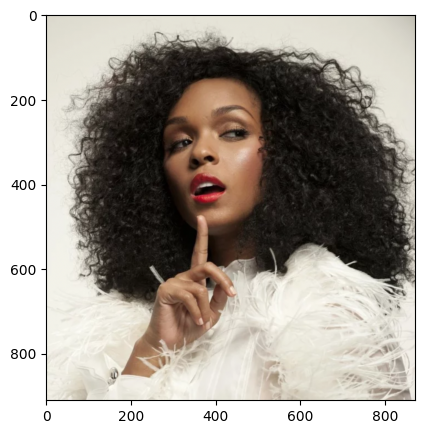

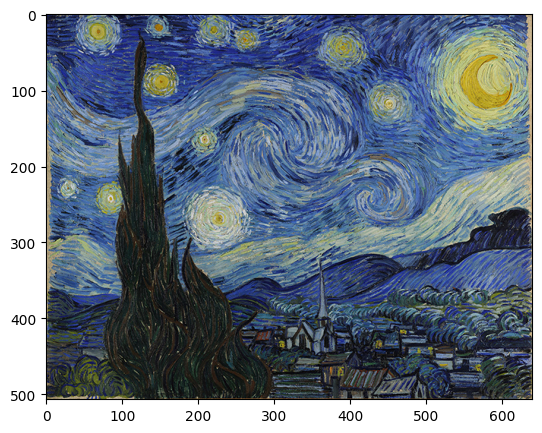

In [ ]:
# Load Images
content_img = load_image(CONTENT_PATH)
style_img = load_image(STYLE_PATH)

# Show Images
show(content_img)
show(style_img)

Style Loss: 63067564.0 Content Loss: 1237537.75 TV Loss: 1.6959991455078125 Total Loss : 64305100.0


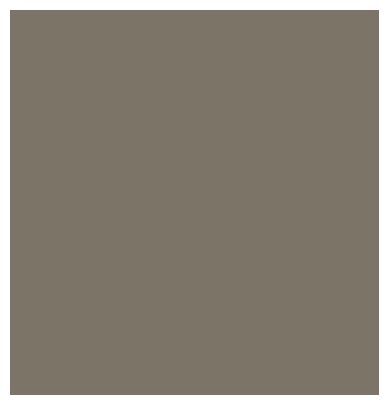

Style Loss: 268648.25 Content Loss: 881982.4375 TV Loss: 31208.4375 Total Loss : 1181839.25


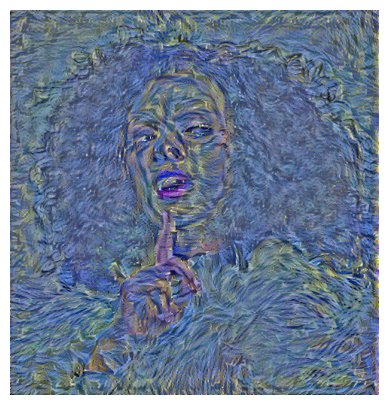

Style Loss: 184495.359375 Content Loss: 711884.25 TV Loss: 31265.47265625 Total Loss : 927645.125


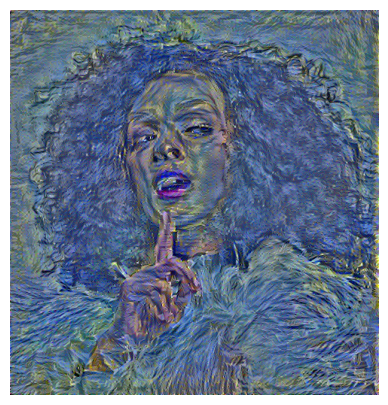

Style Loss: 135582.90625 Content Loss: 644231.25 TV Loss: 31616.23046875 Total Loss : 811430.375


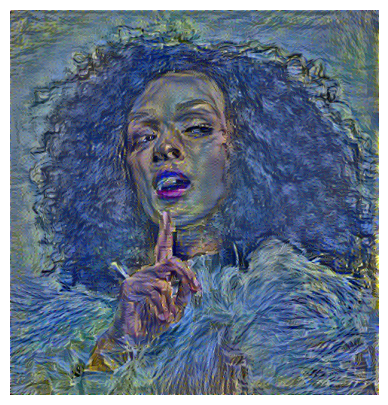

Style Loss: 181636.859375 Content Loss: 622633.875 TV Loss: 32172.7421875 Total Loss : 836443.5


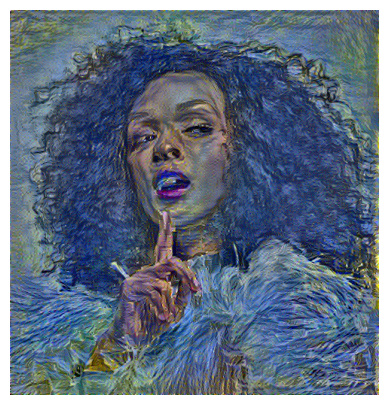

Style Loss: 129598.1171875 Content Loss: 642242.5 TV Loss: 32708.701171875 Total Loss : 804549.3125


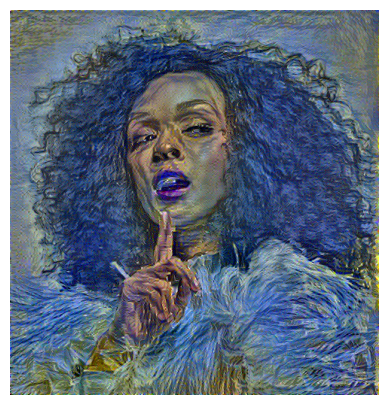

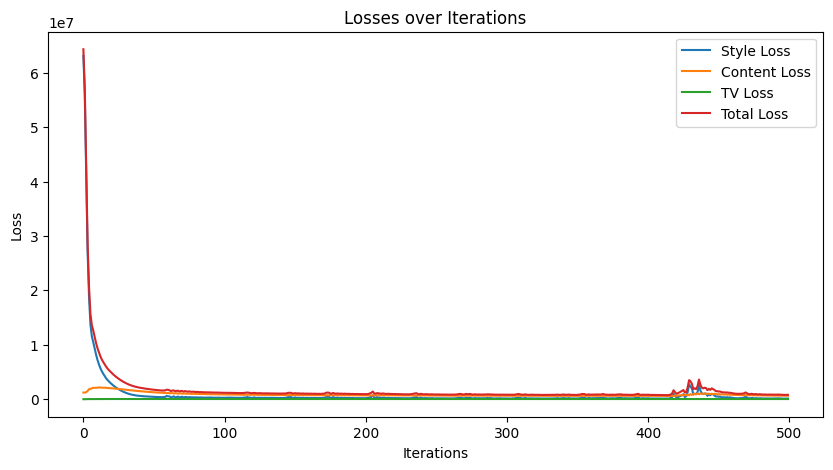

In [ ]:
if (OPTIMIZER=='lbfgs'):
    optimizer = optim.LBFGS([g])
elif (OPTIMIZER=='adam'):
    optimizer = optim.Adam([g], lr=ADAM_LR)

# Stylize without color preservation
out = stylize(iteration=NUM_ITER)

cuda


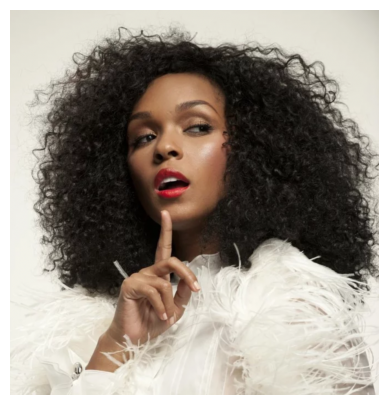

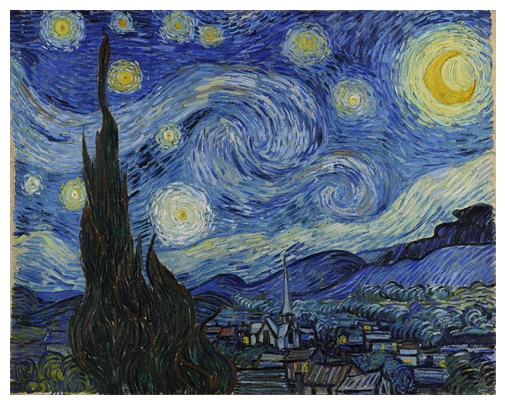

In [ ]:
import torch
import torch.nn as nn
import torch.optim as optim
import copy
import numpy as np
import matplotlib.pyplot as plt
from torchvision import models, transforms
import cv2

# Hyperparameters
MAX_IMAGE_SIZE = 512
OPTIMIZER = 'adam'  # or 'lbfgs'
ADAM_LR = 10
CONTENT_WEIGHT = 5e0
STYLE_WEIGHT = 1e2
TV_WEIGHT = 1e-3
NUM_ITER = 500
SHOW_ITER = 100

# Image Files
INIT_IMAGE = 'random'  # or 'content'
PRESERVE_COLOR = 'False'  # 'False'
PIXEL_CLIP = 'True'  # or 'False' - Clipping produces better images
CONTENT_PATH = '/content/drive/MyDrive/NST/1-content.png'
STYLE_PATH = '/content/drive/MyDrive/NST/1-style.jpg'
VGG19_PATH = '/content/drive/MyDrive/NST/vgg19-d01eb7cb.pth'
POOL = 'avg'

# Print the device
device = "cuda" if torch.cuda.is_available() else "cpu"
print(device)

# Load image file
def load_image(path):
    img = cv2.imread(path)
    return img

# Show image
def show(img):
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    img = np.array(img / 255).clip(0, 1)
    plt.figure(figsize=(10, 5))
    plt.imshow(img)
    plt.axis('off')  # Turn off axis
    plt.show()

# Save Image as out{num_iterms}.png
def saveimg(img, iters):
    if PIXEL_CLIP == 'True':
        img = img.clip(0, 255)
    cv2.imwrite(f'out{iters}.png', img)

# Color transfer
def transfer_color(src, dest):
    if PIXEL_CLIP == 'True':
        src, dest = src.clip(0, 255), dest.clip(0, 255)

    H, W, _ = src.shape
    dest = cv2.resize(dest, dsize=(W, H), interpolation=cv2.INTER_CUBIC)
    dest_gray = cv2.cvtColor(dest, cv2.COLOR_BGR2GRAY)
    src_yiq = cv2.cvtColor(src, cv2.COLOR_BGR2YCrCb)
    src_yiq[..., 0] = dest_gray
    return cv2.cvtColor(src_yiq, cv2.COLOR_YCrCb2BGR)

# Preprocessing
def itot(img):
    H, W, C = img.shape
    image_size = tuple([int((float(MAX_IMAGE_SIZE) / max([H, W])) * x) for x in [H, W]])

    itot_t = transforms.Compose([
        transforms.ToPILImage(),
        transforms.Resize(image_size),
        transforms.ToTensor()
    ])

    normalize_t = transforms.Normalize([103.939, 116.779, 123.68], [1, 1, 1])
    tensor = normalize_t(itot_t(img) * 255)
    tensor = tensor.unsqueeze(dim=0)
    return tensor

def ttoi(tensor):
    ttoi_t = transforms.Compose([
        transforms.Normalize([-103.939, -116.779, -123.68], [1, 1, 1])])

    tensor = tensor.squeeze()
    img = ttoi_t(tensor)
    img = img.cpu().numpy()
    img = img.transpose(1, 2, 0)
    return img

# Load Images
content_img = load_image(CONTENT_PATH)
style_img = load_image(STYLE_PATH)

# Show Images
show(content_img)
show(style_img)

# Load VGG19 Skeleton
vgg = models.vgg19(pretrained=False)
vgg.load_state_dict(torch.load(VGG19_PATH), strict=False)

# Change Pooling Layer
def pool_(model, pool='avg'):
    if (pool=='avg'):
        ct=0
        for layer in model.children():
            if isinstance(layer, nn.MaxPool2d):
                model[ct] = nn.AvgPool2d(kernel_size=2, stride=2, padding=0, ceil_mode=False)
            ct+=1
    elif (pool=='max'):
        ct=0
        for layer in model.children():
            if isinstance(layer, nn.AvgPool2d):
                model[ct] = nn.MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
            ct+=1

    return model

vgg.features = pool_(vgg.features, POOL)

model = copy.deepcopy(vgg.features)
model.to(device)

for param in model.parameters():
    param.requires_grad = False

mse_loss = torch.nn.MSELoss()
def gram(tensor):
    B, C, H, W = tensor.shape
    x = tensor.view(C, H * W)
    return torch.mm(x, x.t())

def content_loss(g, c):
    loss = mse_loss(g, c)
    return loss

def style_loss(g, s):
    c1, c2 = g.shape
    loss = mse_loss(g, s)
    return loss / (c1 ** 2)

def tv_loss(c):
    x = c[:, :, 1:, :] - c[:, :, :-1, :]
    y = c[:, :, :, 1:] - c[:, :, :, :-1]
    loss = torch.sum(torch.abs(x)) + torch.sum(torch.abs(y))
    return loss

def get_features(model, tensor):
    layers = {
        '3': 'relu1_2',
        '8': 'relu2_2',
        '17': 'relu3_3',
        '26': 'relu4_3',
        '35': 'relu5_3',
        '22': 'relu4_2',
    }

    features = {}
    x = tensor
    for name, layer in model._modules.items():
        x = layer(x)
        if name in layers:
            if name == '22':
                features[layers[name]] = x
            elif name == '31':
                features[layers[name]] = x
            else:
                b, c, h, w = x.shape
                features[layers[name]] = gram(x) / (h * w)
            if name == '35':
                break

    return features

def initial(content_tensor, init_image='random'):
    B, C, H, W = content_tensor.shape
    if init_image == 'random':
        tensor = torch.randn(C, H, W).mul(0.001).unsqueeze(0)
    else:
        tensor = content_tensor.clone().detach()

    return tensor

content_tensor = itot(content_img).to(device)
style_tensor = itot(style_img).to(device)
g = initial(content_tensor, init_image=INIT_IMAGE)
g = g.to(device).requires_grad_(True)

def stylize(iteration=NUM_ITER, preserve_color=False):
    # Initialize lists for storing loss values and iterations
    style_losses = []
    content_losses = []
    tv_losses = []
    total_losses = []
    iterations = []

    # Get features representations/Forward pass
    content_layers = ['relu4_2']
    content_weights = {'relu4_2': 1.0}
    style_layers = ['relu1_2', 'relu2_2', 'relu3_3', 'relu4_3', 'relu5_3']
    style_weights = {'relu1_2': 0.2, 'relu2_2': 0.2, 'relu3_3': 0.2, 'relu4_3': 0.2, 'relu5_3': 0.2}
    c_feat = get_features(model, content_tensor)
    s_feat = get_features(model, style_tensor)

    i = [0]
    while i[0] < iteration:
        def closure():
            # Zero-out gradients
            optimizer.zero_grad()

            # Forward pass
            g_feat = get_features(model, g)

            # Compute Losses
            c_loss = 0
            s_loss = 0
            for j in content_layers:
                c_loss += content_weights[j] * content_loss(g_feat[j], c_feat[j])
            for j in style_layers:
                s_loss += style_weights[j] * style_loss(g_feat[j], s_feat[j])

            c_loss = CONTENT_WEIGHT * c_loss
            s_loss = STYLE_WEIGHT * s_loss
            t_loss = TV_WEIGHT * tv_loss(g.clone().detach())
            total_loss = c_loss + s_loss + t_loss

            # Backprop
            total_loss.backward(retain_graph=True)

            # Append loss values and iteration number
            style_losses.append(s_loss.item())
            content_losses.append(c_loss.item())
            tv_losses.append(t_loss.item())
            total_losses.append(total_loss.item())
            iterations.append(i[0])

            # Print Loss, show and save image
            i[0] += 1
            if (((i[0] % SHOW_ITER) == 1) or (i[0] == NUM_ITER)):
                print("Style Loss: {} Content Loss: {} TV Loss: {} Total Loss : {}".format(s_loss.item(), c_loss.item(),
                                                                                            t_loss, total_loss.item()))
                g_ = ttoi(g.clone().detach())
                show(g_)
                saveimg(g_, i[0] - 1)
                plt.show()

            return total_loss

        # Weight/Pixel update
        optimizer.step(closure)

    if (preserve_color):
        original_colored = ttoi(content_tensor.clone().detach())
        final_with_color = transfer_color(original_colored, g_)
        show(final_with_color)
        saveimg(final_with_color, NUM_ITER)

    # Plotting Combined Graph
    plt.figure(figsize=(10, 5))
    plt.plot(iterations, style_losses, label='Style Loss')
    plt.plot(iterations, content_losses, label='Content Loss')
    plt.plot(iterations, tv_losses, label='TV Loss')
    plt.plot(iterations, total_losses, label='Total Loss')
    plt.xlabel('Iterations')
    plt.ylabel('Loss')
    plt.title('Losses over Iterations')
    plt.legend()
    plt.show()

    return g


Style Loss: 8000398.5 Content Loss: 301280.875 TV Loss: 1.6958153247833252 Total Loss : 8301681.0


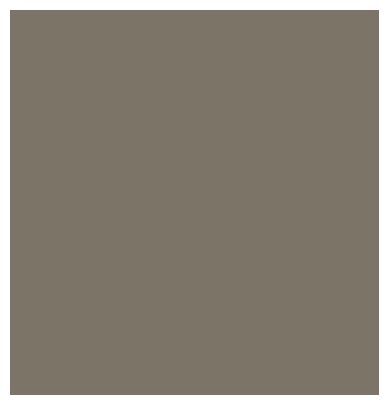

Style Loss: 39868.8984375 Content Loss: 188752.953125 TV Loss: 26955.826171875 Total Loss : 255577.671875


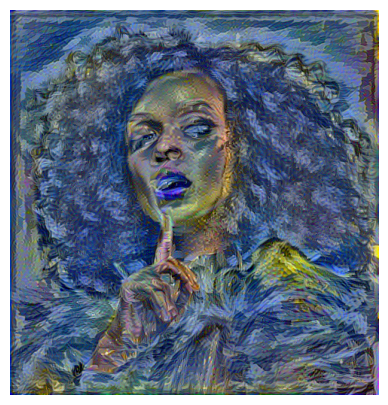

Style Loss: 21204.115234375 Content Loss: 146520.5625 TV Loss: 27676.064453125 Total Loss : 195400.734375


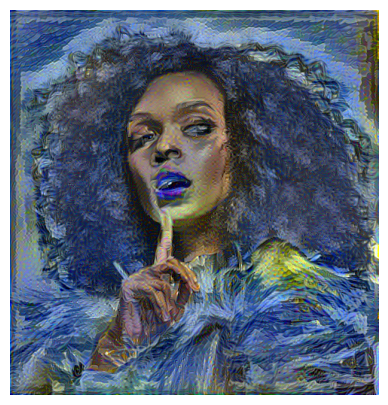

Style Loss: 20680.70703125 Content Loss: 128891.4453125 TV Loss: 27904.70703125 Total Loss : 177476.859375


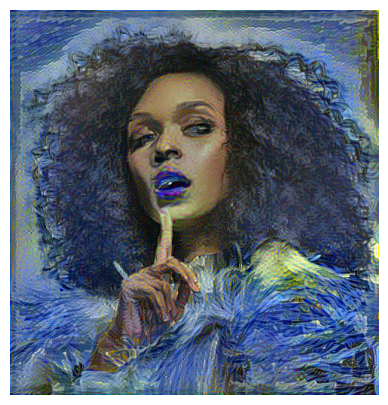

Style Loss: 18098.77734375 Content Loss: 124375.21875 TV Loss: 27934.376953125 Total Loss : 170408.375


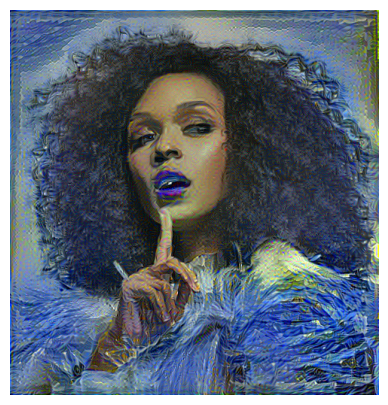

Style Loss: 18995.5625 Content Loss: 123977.2734375 TV Loss: 28072.125 Total Loss : 171044.96875


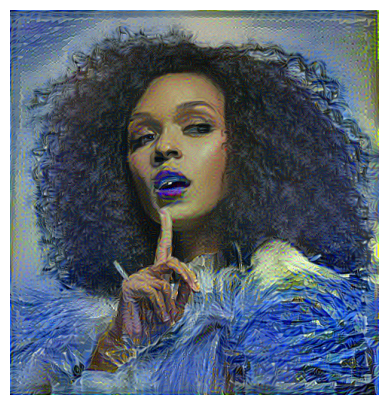

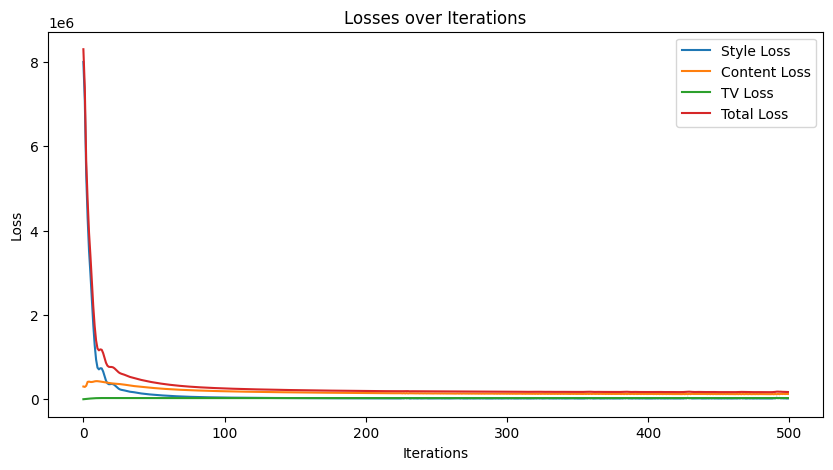

In [ ]:
if (OPTIMIZER=='lbfgs'):
    optimizer = optim.LBFGS([g])
elif (OPTIMIZER=='adam'):
    optimizer = optim.Adam([g], lr=ADAM_LR)

# Stylize without color preservation
out = stylize(iteration=NUM_ITER)

cuda


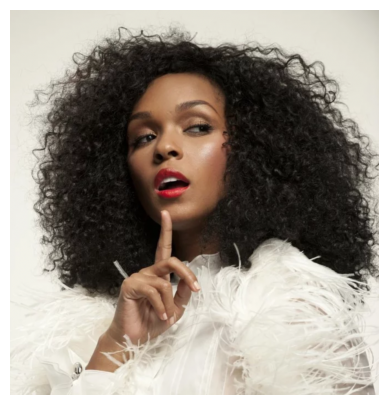

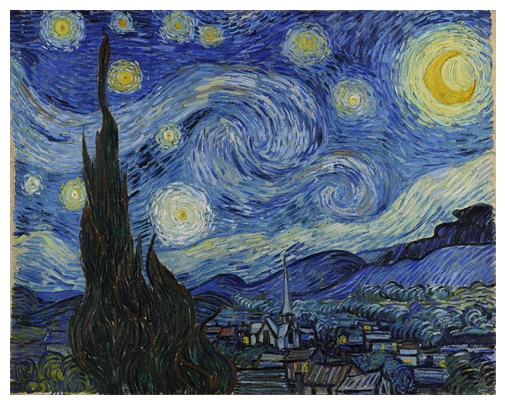

In [ ]:
import torch
import torch.nn as nn
import torch.optim as optim
import copy
import numpy as np
import matplotlib.pyplot as plt
from torchvision import models, transforms
import cv2

# Hyperparameters
MAX_IMAGE_SIZE = 512
OPTIMIZER = 'adam'  # or 'lbfgs'
ADAM_LR = 10
CONTENT_WEIGHT = 5e0
STYLE_WEIGHT = 1e2
TV_WEIGHT = 1e-3
NUM_ITER = 3000
SHOW_ITER = 500

# Image Files
INIT_IMAGE = 'random'  # or 'content'
PRESERVE_COLOR = 'False'  # 'False'
PIXEL_CLIP = 'True'  # or 'False' - Clipping produces better images
CONTENT_PATH = '/content/drive/MyDrive/NST/1-content.png'
STYLE_PATH = '/content/drive/MyDrive/NST/1-style.jpg'
VGG19_PATH = '/content/drive/MyDrive/NST/vgg19-d01eb7cb.pth'
POOL = 'max'

# Print the device
device = "cuda" if torch.cuda.is_available() else "cpu"
print(device)

# Load image file
def load_image(path):
    img = cv2.imread(path)
    return img

# Show image
def show(img):
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    img = np.array(img / 255).clip(0, 1)
    plt.figure(figsize=(10, 5))
    plt.imshow(img)
    plt.axis('off')  # Turn off axis
    plt.show()

# Save Image as out{num_iterms}.png
def saveimg(img, iters):
    if PIXEL_CLIP == 'True':
        img = img.clip(0, 255)
    cv2.imwrite(f'out{iters}.png', img)

# Color transfer
def transfer_color(src, dest):
    if PIXEL_CLIP == 'True':
        src, dest = src.clip(0, 255), dest.clip(0, 255)

    H, W, _ = src.shape
    dest = cv2.resize(dest, dsize=(W, H), interpolation=cv2.INTER_CUBIC)
    dest_gray = cv2.cvtColor(dest, cv2.COLOR_BGR2GRAY)
    src_yiq = cv2.cvtColor(src, cv2.COLOR_BGR2YCrCb)
    src_yiq[..., 0] = dest_gray
    return cv2.cvtColor(src_yiq, cv2.COLOR_YCrCb2BGR)

# Preprocessing
def itot(img):
    H, W, C = img.shape
    image_size = tuple([int((float(MAX_IMAGE_SIZE) / max([H, W])) * x) for x in [H, W]])

    itot_t = transforms.Compose([
        transforms.ToPILImage(),
        transforms.Resize(image_size),
        transforms.ToTensor()
    ])

    normalize_t = transforms.Normalize([103.939, 116.779, 123.68], [1, 1, 1])
    tensor = normalize_t(itot_t(img) * 255)
    tensor = tensor.unsqueeze(dim=0)
    return tensor

def ttoi(tensor):
    ttoi_t = transforms.Compose([
        transforms.Normalize([-103.939, -116.779, -123.68], [1, 1, 1])])

    tensor = tensor.squeeze()
    img = ttoi_t(tensor)
    img = img.cpu().numpy()
    img = img.transpose(1, 2, 0)
    return img

# Load Images
content_img = load_image(CONTENT_PATH)
style_img = load_image(STYLE_PATH)

# Show Images
show(content_img)
show(style_img)

# Load VGG19 Skeleton
vgg = models.vgg19(pretrained=False)
vgg.load_state_dict(torch.load(VGG19_PATH), strict=False)
model = copy.deepcopy(vgg.features)
model.to(device)

for param in model.parameters():
    param.requires_grad = False

mse_loss = torch.nn.MSELoss()
def gram(tensor):
    B, C, H, W = tensor.shape
    x = tensor.view(C, H * W)
    return torch.mm(x, x.t())

def content_loss(g, c):
    loss = mse_loss(g, c)
    return loss

def style_loss(g, s):
    c1, c2 = g.shape
    loss = mse_loss(g, s)
    return loss / (c1 ** 2)

def tv_loss(c):
    x = c[:, :, 1:, :] - c[:, :, :-1, :]
    y = c[:, :, :, 1:] - c[:, :, :, :-1]
    loss = torch.sum(torch.abs(x)) + torch.sum(torch.abs(y))
    return loss

def get_features(model, tensor):
    layers = {
        '3': 'relu1_2',
        '8': 'relu2_2',
        '17': 'relu3_3',
        '26': 'relu4_3',
        '35': 'relu5_3',
        '22': 'relu4_2',
    }

    features = {}
    x = tensor
    for name, layer in model._modules.items():
        x = layer(x)
        if name in layers:
            if name == '22':
                features[layers[name]] = x
            elif name == '31':
                features[layers[name]] = x
            else:
                b, c, h, w = x.shape
                features[layers[name]] = gram(x) / (h * w)
            if name == '35':
                break

    return features

def initial(content_tensor, init_image='random'):
    B, C, H, W = content_tensor.shape
    if init_image == 'random':
        tensor = torch.randn(C, H, W).mul(0.001).unsqueeze(0)
    else:
        tensor = content_tensor.clone().detach()

    return tensor

content_tensor = itot(content_img).to(device)
style_tensor = itot(style_img).to(device)
g = initial(content_tensor, init_image=INIT_IMAGE)
g = g.to(device).requires_grad_(True)

def stylize(iteration=NUM_ITER, preserve_color=False):
    # Initialize lists for storing loss values and iterations
    style_losses = []
    content_losses = []
    tv_losses = []
    total_losses = []
    iterations = []

    # Get features representations/Forward pass
    content_layers = ['relu4_2']
    content_weights = {'relu4_2': 1.0}
    style_layers = ['relu1_2', 'relu2_2', 'relu3_3', 'relu4_3', 'relu5_3']
    style_weights = {'relu1_2': 0.2, 'relu2_2': 0.2, 'relu3_3': 0.2, 'relu4_3': 0.2, 'relu5_3': 0.2}
    c_feat = get_features(model, content_tensor)
    s_feat = get_features(model, style_tensor)

    i = [0]
    while i[0] < iteration:
        def closure():
            # Zero-out gradients
            optimizer.zero_grad()

            # Forward pass
            g_feat = get_features(model, g)

            # Compute Losses
            c_loss = 0
            s_loss = 0
            for j in content_layers:
                c_loss += content_weights[j] * content_loss(g_feat[j], c_feat[j])
            for j in style_layers:
                s_loss += style_weights[j] * style_loss(g_feat[j], s_feat[j])

            c_loss = CONTENT_WEIGHT * c_loss
            s_loss = STYLE_WEIGHT * s_loss
            t_loss = TV_WEIGHT * tv_loss(g.clone().detach())
            total_loss = c_loss + s_loss + t_loss

            # Backprop
            total_loss.backward(retain_graph=True)

            # Append loss values and iteration number
            style_losses.append(s_loss.item())
            content_losses.append(c_loss.item())
            tv_losses.append(t_loss.item())
            total_losses.append(total_loss.item())
            iterations.append(i[0])

            # Print Loss, show and save image
            i[0] += 1
            if (((i[0] % SHOW_ITER) == 1) or (i[0] == NUM_ITER)):
                print("Style Loss: {} Content Loss: {} TV Loss: {} Total Loss : {}".format(s_loss.item(), c_loss.item(),
                                                                                            t_loss, total_loss.item()))
                g_ = ttoi(g.clone().detach())
                show(g_)
                saveimg(g_, i[0] - 1)
                plt.show()

            return total_loss

        # Weight/Pixel update
        optimizer.step(closure)

    if (preserve_color):
        original_colored = ttoi(content_tensor.clone().detach())
        final_with_color = transfer_color(original_colored, g_)
        show(final_with_color)
        saveimg(final_with_color, NUM_ITER)

    # Plotting Combined Graph
    plt.figure(figsize=(10, 5))
    plt.plot(iterations, style_losses, label='Style Loss')
    plt.plot(iterations, content_losses, label='Content Loss')
    plt.plot(iterations, tv_losses, label='TV Loss')
    plt.plot(iterations, total_losses, label='Total Loss')
    plt.xlabel('Iterations')
    plt.ylabel('Loss')
    plt.title('Losses over Iterations')
    plt.legend()
    plt.show()

    return g


Style Loss: 63067564.0 Content Loss: 1237537.75 TV Loss: 1.6959562301635742 Total Loss : 64305100.0


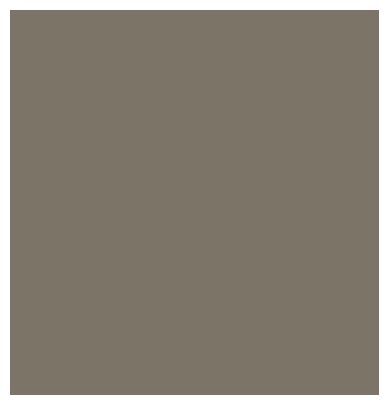

Style Loss: 121709.7421875 Content Loss: 595296.5 TV Loss: 32291.501953125 Total Loss : 749297.75


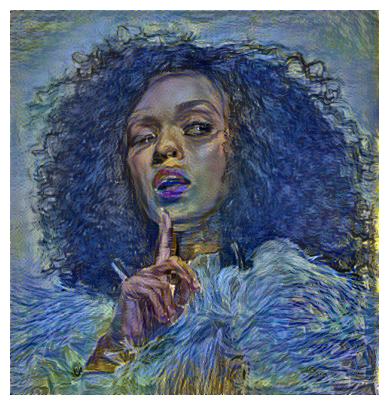

Style Loss: 125120.53125 Content Loss: 647228.1875 TV Loss: 38811.96875 Total Loss : 811160.75


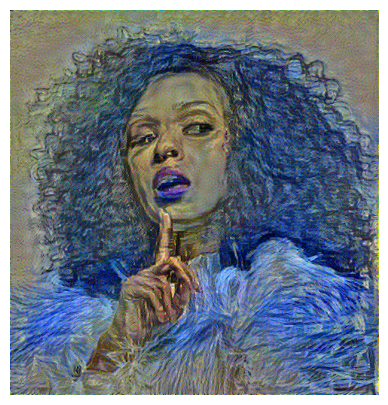

Style Loss: 88935.078125 Content Loss: 546883.5 TV Loss: 37773.984375 Total Loss : 673592.5625


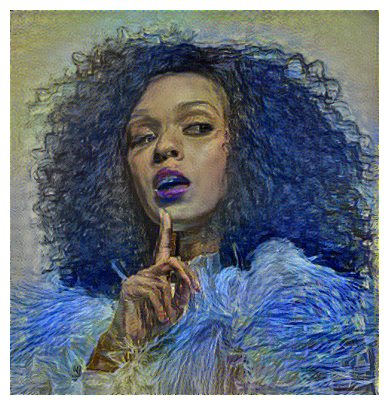

Style Loss: 84801.0390625 Content Loss: 516992.6875 TV Loss: 37830.51953125 Total Loss : 639624.25


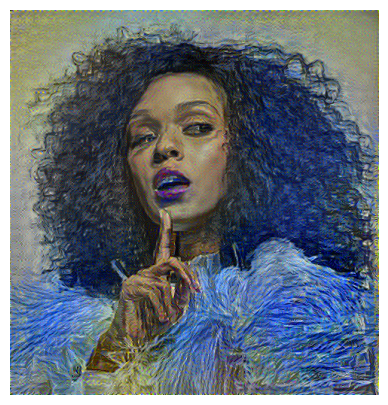

Style Loss: 231889.546875 Content Loss: 828243.375 TV Loss: 50448.546875 Total Loss : 1110581.375


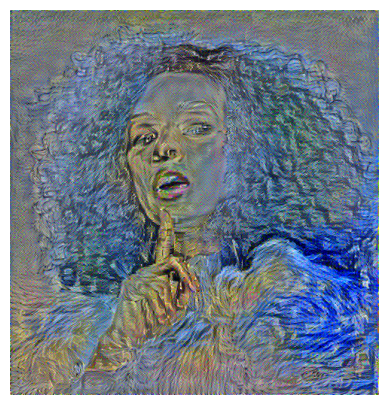

Style Loss: 106672.0546875 Content Loss: 584243.75 TV Loss: 47504.6171875 Total Loss : 738420.4375


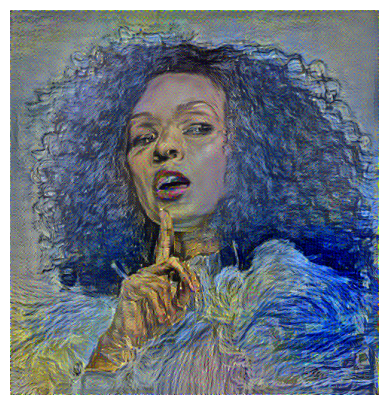

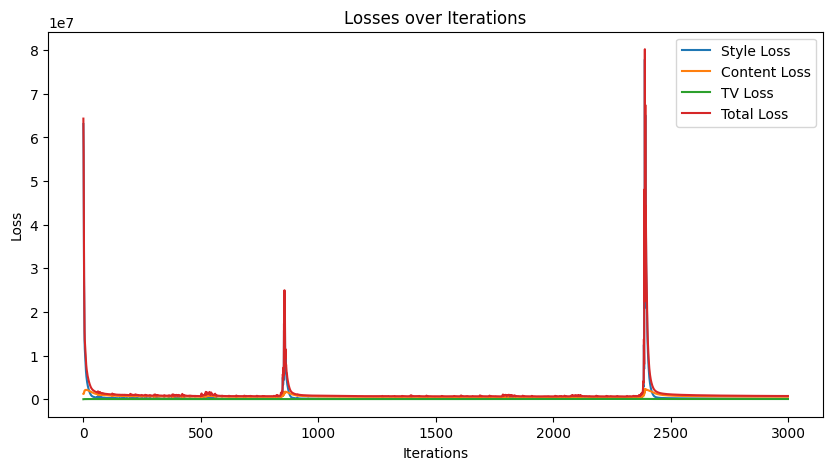

In [ ]:
if (OPTIMIZER=='lbfgs'):
    optimizer = optim.LBFGS([g])
elif (OPTIMIZER=='adam'):
    optimizer = optim.Adam([g], lr=ADAM_LR)

# Stylize without color preservation
out = stylize(iteration=NUM_ITER)

# ***adam with 500 iteration but change in weights -> pooling = max***

In [ ]:
# Hyperparameters
MAX_IMAGE_SIZE = 512

# Optimizer
OPTIMIZER = 'adam'
'''LR = 5
CONTENT_WEIGHT = 3
STYLE_WEIGHT = 1e6
TV_WEIGHT = 1e-3
NUM_ITER = 500
SHOW_ITER = 100'''
LR = 10
CONTENT_WEIGHT = 5
STYLE_WEIGHT = 1e-3
TV_WEIGHT = 1e-5
NUM_ITER = 500
SHOW_ITER = 100
# Image
INIT_IMAGE = 'random' # or 'content'
PRESERVE_COLOR = 'False' # or 'True'
PIXEL_CLIP = 'True'
CONTENT_PATH = '/content/drive/MyDrive/color preserve/1-content.png'
STYLE_PATH = '/content/drive/MyDrive/color preserve/1-style.jpg'

# Models
VGG19_PATH = '/content/drive/MyDrive/color preserve/vgg19-d01eb7cb.pth'
POOL = 'max'

In [ ]:
# Preprocessing
def itot(img):
    # Rescale the image
    H, W, C = img.shape
    image_size = tuple([int((float(MAX_IMAGE_SIZE) / max([H,W]))*x) for x in [H, W]])

    itot_t = transforms.Compose([
        transforms.ToPILImage(),
        transforms.Resize(image_size),
        transforms.ToTensor()
    ])

    # Subtract the means
    normalize_t = transforms.Normalize([103.939, 116.779, 123.68],[1,1,1])
    tensor = normalize_t(itot_t(img)*255)

    # Add the batch_size dimension
    tensor = tensor.unsqueeze(dim=0)
    return tensor

def ttoi(tensor):
    # Add the means
    ttoi_t = transforms.Compose([
        transforms.Normalize([-103.939, -116.779, -123.68],[1,1,1])])

    # Remove the batch_size dimension
    tensor = tensor.squeeze()
    img = ttoi_t(tensor)
    img = img.cpu().numpy()

    # Transpose from [C, H, W] -> [H, W, C]
    img = img.transpose(1, 2, 0)
    return img

In [ ]:
# Load VGG19 Skeleton
vgg = models.vgg19(pretrained=False)
# Load pretrained weights
vgg.load_state_dict(torch.load(VGG19_PATH), strict=False)

def pool_(model, pool='avg'):
    if (pool=='avg'):
        ct=0
        for layer in model.children():
            if isinstance(layer, nn.MaxPool2d):
                model[ct] = nn.AvgPool2d(kernel_size=2, stride=2, padding=0, ceil_mode=False)
            ct+=1
    elif (pool=='max'):
        ct=0
        for layer in model.children():
            if isinstance(layer, nn.AvgPool2d):
                model[ct] = nn.MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
            ct+=1

    return model

model = copy.deepcopy(vgg.features)
model.to(device)

for param in model.parameters():
    param.requires_grad = False

In [ ]:
# Loss Calculation
mse_loss = torch.nn.MSELoss()
def gram(tensor):
    B, C, H, W = tensor.shape
    x = tensor.view(C, H*W)
    return torch.mm(x, x.t())

def content_loss(g, c):
    loss = mse_loss(g, c)
    return loss

def style_loss(g, s):
    c1,c2 = g.shape
    loss = mse_loss(g, s)
    return loss / (c1**2) # Divide by square of channels

def tv_loss(c):
    x = c[:,:,1:,:] - c[:,:,:-1,:]
    y = c[:,:,:,1:] - c[:,:,:,:-1]
    loss = torch.sum(torch.abs(x)) + torch.sum(torch.abs(y))
    return loss

In [ ]:
# VGG Forward Pass
def get_features(model, tensor):
    layers = {
        '3': 'relu1_2',   # Style layers
        '8': 'relu2_2',
        '17' : 'relu3_3',
        '26' : 'relu4_3',
        '35' : 'relu5_3',
        '22' : 'relu4_2', # Content layers
        #'31' : 'relu5_2'
    }

    # Get features
    features = {}
    x = tensor
    for name, layer in model._modules.items():
        x = layer(x)
        if name in layers:
            if (name=='22'):   # relu4_2
                features[layers[name]] = x
            elif (name=='31'): # relu5_2
                features[layers[name]] = x
            else:
                b, c, h, w = x.shape
                features[layers[name]] = gram(x) / (h*w)

            # Terminate forward pass
            if (name == '35'):
                break

    return features

In [ ]:
def initial(content_tensor, init_image='random'):
    B, C, H, W = content_tensor.shape
    if (init_image=='random'):
        tensor = torch.randn(C, H, W).mul(0.001).unsqueeze(0)
    else:
        tensor = content_tensor.clone().detach()

    return tensor

content_tensor = itot(content_img).to(device)
style_tensor = itot(style_img).to(device)
g = initial(content_tensor, init_image=INIT_IMAGE)
g = g.to(device).requires_grad_(True)

In [ ]:
def stylize(iteration=NUM_ITER):
    content_layers = ['relu4_2']
    content_weights = {'relu4_2': 1.0}
    style_layers = ['relu1_2', 'relu2_2', 'relu3_3', 'relu4_3', 'relu5_3']
    style_weights = {'relu1_2': 0.2, 'relu2_2': 0.2, 'relu3_3': 0.2, 'relu4_3': 0.2, 'relu5_3': 0.2}
    c_feat = get_features(model, content_tensor)
    s_feat = get_features(model, style_tensor)

    i = [0]
    while i[0] < iteration:
        def closure():
            optimizer.zero_grad()

            g_feat = get_features(model, g)

            c_loss = 0
            s_loss = 0
            for j in content_layers:
                c_loss += content_weights[j] * content_loss(g_feat[j], c_feat[j])
            for j in style_layers:
                s_loss += style_weights[j] * style_loss(g_feat[j], s_feat[j])
            c_loss = CONTENT_WEIGHT * c_loss
            s_loss = STYLE_WEIGHT * s_loss
            t_loss = TV_WEIGHT * tv_loss(g.clone().detach())
            total_loss = c_loss + s_loss + t_loss
            total_loss.backward(retain_graph=True)

            i[0] += 1
            if (((i[0] % SHOW_ITER) == 1) or (i[0] == NUM_ITER)):
                print("Style Loss: {} Content Loss: {} TV Loss: {} Total Loss : {}".format(s_loss.item(), c_loss.item(), t_loss, total_loss.item()))
                if (PRESERVE_COLOR == 'True'):
                    g_ = transfer_color(ttoi(content_tensor.clone().detach()), ttoi(g.clone().detach()))
                else:
                    g_ = ttoi(g.clone().detach())
                show(g_)
                saveimg(g_, i[0] - 1)
                plt.show()
            return (total_loss)
        optimizer.step(closure)

    return g


Style Loss: 630.6756591796875 Content Loss: 1237537.5 TV Loss: 0.01695150136947632 Total Loss : 1238168.125


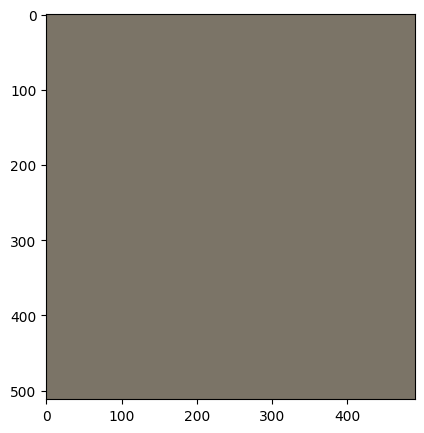

Style Loss: 350.7507019042969 Content Loss: 86818.9140625 TV Loss: 335.2191162109375 Total Loss : 87504.8828125


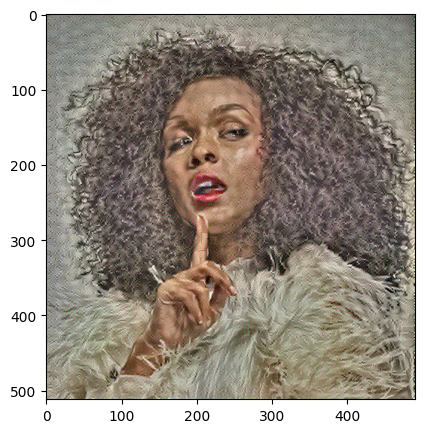

Style Loss: 358.9154052734375 Content Loss: 65506.67578125 TV Loss: 348.7808837890625 Total Loss : 66214.375


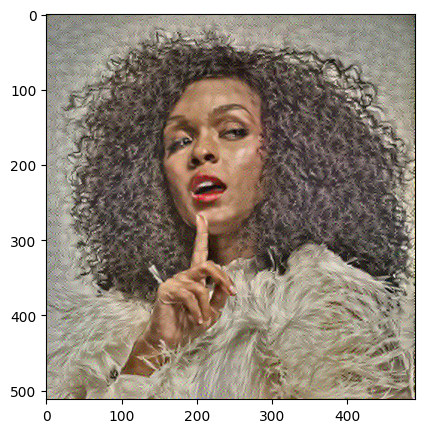

Style Loss: 362.7950134277344 Content Loss: 57609.90234375 TV Loss: 362.4479064941406 Total Loss : 58335.1484375


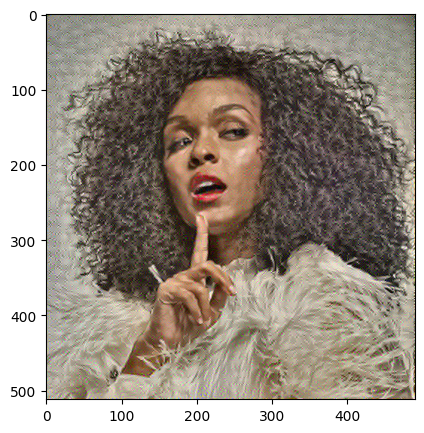

Style Loss: 365.8236999511719 Content Loss: 54063.234375 TV Loss: 375.1016845703125 Total Loss : 54804.16015625


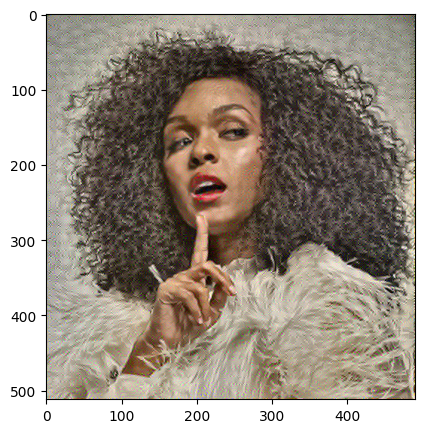

Style Loss: 368.50994873046875 Content Loss: 49350.9296875 TV Loss: 385.90460205078125 Total Loss : 50105.34765625


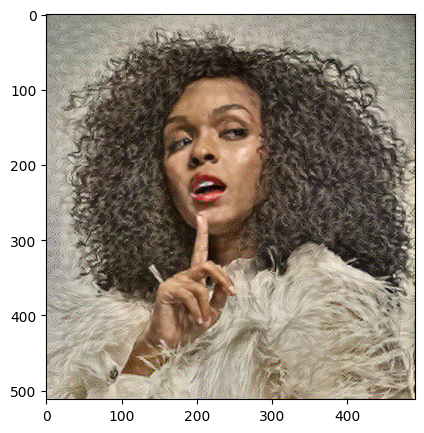

In [ ]:
if (OPTIMIZER == 'sgd'):
    optimizer = optim.SGD([g], lr=LR)

else:
    if (OPTIMIZER == 'lbfgs'):
        optimizer = optim.LBFGS([g])
    else:
        optimizer = optim.Adam([g], lr=LR)

# Stylize!
out = stylize(iteration=NUM_ITER)

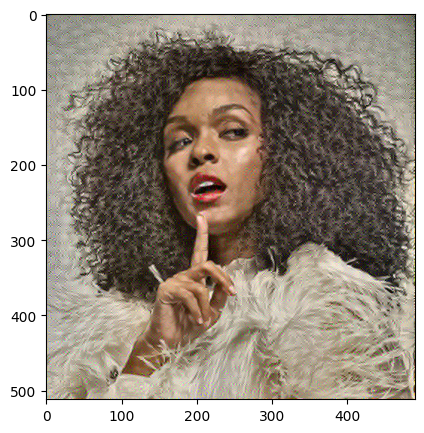

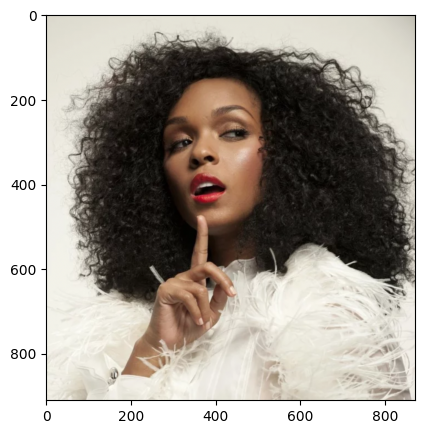

In [ ]:
show(ttoi(g.clone().detach()))
show(content_img)
saveimg(ttoi(g.clone().detach()), NUM_ITER)

if (PRESERVE_COLOR=='True'):
    c_clone = ttoi(content_tensor.clone().detach())
    g_clone = ttoi(g.clone().detach())
    g_preserve = transfer_color(c_clone, g_clone)
    show(g_preserve)
    saveimg(g_preserve, 333)

# ***lbfgs with 500 iteration same weights -> pooling = max***

In [ ]:
# Hyperparameters
MAX_IMAGE_SIZE = 512

# Optimizer
OPTIMIZER = 'lbfgs'
ADAM_LR = 10
CONTENT_WEIGHT = 5e0
STYLE_WEIGHT = 1e2
TV_WEIGHT = 1e-3
NUM_ITER = 500
SHOW_ITER = 100

# Image
INIT_IMAGE = 'random' # or 'content'
PRESERVE_COLOR = 'False' # or 'True'
PIXEL_CLIP = 'True'
CONTENT_PATH = '/content/drive/MyDrive/color preserve/1-content.png'
STYLE_PATH = '/content/drive/MyDrive/color preserve/1-style.jpg'

# Models
VGG19_PATH = '/content/drive/MyDrive/color preserve/vgg19-d01eb7cb.pth'
POOL = 'max'

In [ ]:
# Preprocessing
def itot(img):
    # Rescale the image
    H, W, C = img.shape
    image_size = tuple([int((float(MAX_IMAGE_SIZE) / max([H,W]))*x) for x in [H, W]])

    itot_t = transforms.Compose([
        transforms.ToPILImage(),
        transforms.Resize(image_size),
        transforms.ToTensor()
    ])

    # Subtract the means
    normalize_t = transforms.Normalize([103.939, 116.779, 123.68],[1,1,1])
    tensor = normalize_t(itot_t(img)*255)

    # Add the batch_size dimension
    tensor = tensor.unsqueeze(dim=0)
    return tensor

def ttoi(tensor):
    # Add the means
    ttoi_t = transforms.Compose([
        transforms.Normalize([-103.939, -116.779, -123.68],[1,1,1])])

    # Remove the batch_size dimension
    tensor = tensor.squeeze()
    img = ttoi_t(tensor)
    img = img.cpu().numpy()

    # Transpose from [C, H, W] -> [H, W, C]
    img = img.transpose(1, 2, 0)
    return img

In [ ]:
# Load VGG19 Skeleton
vgg = models.vgg19(pretrained=False)
# Load pretrained weights
vgg.load_state_dict(torch.load(VGG19_PATH), strict=False)

def pool_(model, pool='avg'):
    if (pool=='avg'):
        ct=0
        for layer in model.children():
            if isinstance(layer, nn.MaxPool2d):
                model[ct] = nn.AvgPool2d(kernel_size=2, stride=2, padding=0, ceil_mode=False)
            ct+=1
    elif (pool=='max'):
        ct=0
        for layer in model.children():
            if isinstance(layer, nn.AvgPool2d):
                model[ct] = nn.MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
            ct+=1

    return model

model = copy.deepcopy(vgg.features)
model.to(device)

for param in model.parameters():
    param.requires_grad = False

In [ ]:
# Loss Calculation
mse_loss = torch.nn.MSELoss()
def gram(tensor):
    B, C, H, W = tensor.shape
    x = tensor.view(C, H*W)
    return torch.mm(x, x.t())

def content_loss(g, c):
    loss = mse_loss(g, c)
    return loss

def style_loss(g, s):
    c1,c2 = g.shape
    loss = mse_loss(g, s)
    return loss / (c1**2) # Divide by square of channels

def tv_loss(c):
    x = c[:,:,1:,:] - c[:,:,:-1,:]
    y = c[:,:,:,1:] - c[:,:,:,:-1]
    loss = torch.sum(torch.abs(x)) + torch.sum(torch.abs(y))
    return loss

In [ ]:
# VGG Forward Pass
def get_features(model, tensor):
    layers = {
        '3': 'relu1_2',   # Style layers
        '8': 'relu2_2',
        '17' : 'relu3_3',
        '26' : 'relu4_3',
        '35' : 'relu5_3',
        '22' : 'relu4_2', # Content layers
        #'31' : 'relu5_2'
    }

    # Get features
    features = {}
    x = tensor
    for name, layer in model._modules.items():
        x = layer(x)
        if name in layers:
            if (name=='22'):   # relu4_2
                features[layers[name]] = x
            elif (name=='31'): # relu5_2
                features[layers[name]] = x
            else:
                b, c, h, w = x.shape
                features[layers[name]] = gram(x) / (h*w)

            # Terminate forward pass
            if (name == '35'):
                break

    return features

In [ ]:
def stylize(iteration=NUM_ITER):
    content_layers = ['relu4_2']
    content_weights = {'relu4_2': 1.0}
    style_layers = ['relu1_2', 'relu2_2', 'relu3_3', 'relu4_3', 'relu5_3']
    style_weights = {'relu1_2': 0.2, 'relu2_2': 0.2, 'relu3_3': 0.2, 'relu4_3': 0.2, 'relu5_3': 0.2}
    c_feat = get_features(model, content_tensor)
    s_feat = get_features(model, style_tensor)

    i = [0]
    while i[0] < iteration:
        def closure():
            optimizer.zero_grad()

            g_feat = get_features(model, g)

            c_loss = 0
            s_loss = 0
            for j in content_layers:
                c_loss += content_weights[j] * content_loss(g_feat[j], c_feat[j])
            for j in style_layers:
                s_loss += style_weights[j] * style_loss(g_feat[j], s_feat[j])
            c_loss = CONTENT_WEIGHT * c_loss
            s_loss = STYLE_WEIGHT * s_loss
            t_loss = TV_WEIGHT * tv_loss(g.clone().detach())
            total_loss = c_loss + s_loss + t_loss
            total_loss.backward(retain_graph=True)

            i[0] += 1
            if (((i[0] % SHOW_ITER) == 1) or (i[0] == NUM_ITER)):
                print("Style Loss: {} Content Loss: {} TV Loss: {} Total Loss : {}".format(s_loss.item(), c_loss.item(), t_loss, total_loss.item()))
                if (PRESERVE_COLOR == 'True'):
                    g_ = transfer_color(ttoi(content_tensor.clone().detach()), ttoi(g.clone().detach()))
                else:
                    g_ = ttoi(g.clone().detach())
                show(g_)
                saveimg(g_, i[0] - 1)
                plt.show()
            return (total_loss)
        optimizer.step(closure)

    return g


Style Loss: 63067568.0 Content Loss: 1237537.75 TV Loss: 1.6934564113616943 Total Loss : 64305104.0


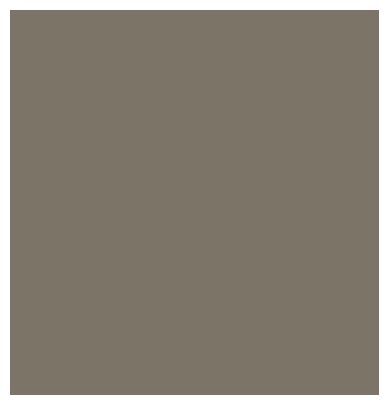

Style Loss: 251448.921875 Content Loss: 871328.4375 TV Loss: 21187.576171875 Total Loss : 1143965.0


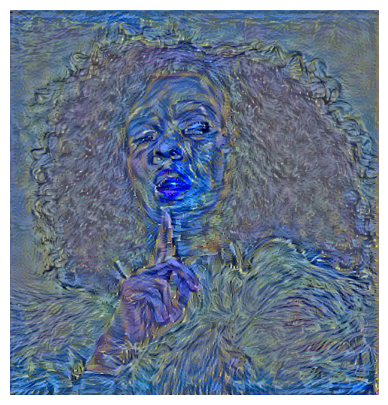

Style Loss: 111146.3515625 Content Loss: 632562.375 TV Loss: 22920.8046875 Total Loss : 766629.5625


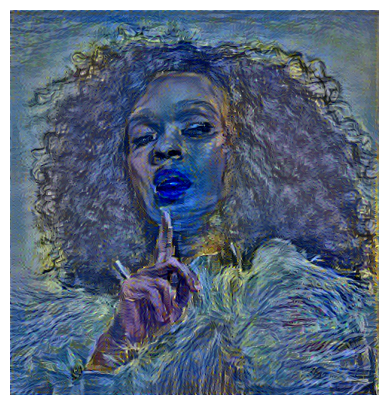

Style Loss: 82541.3359375 Content Loss: 560852.625 TV Loss: 24205.625 Total Loss : 667599.5625


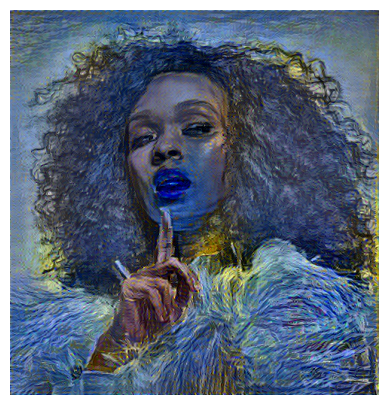

Style Loss: 78007.4140625 Content Loss: 529025.6875 TV Loss: 25312.84375 Total Loss : 632346.0


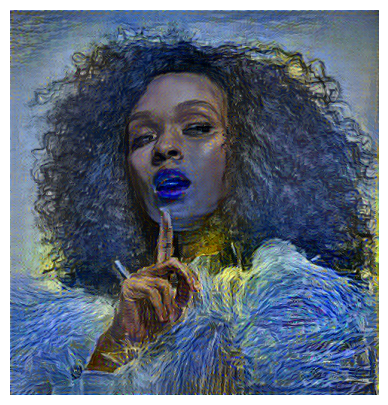

Style Loss: 77531.9765625 Content Loss: 514600.25 TV Loss: 26468.8125 Total Loss : 618601.0625


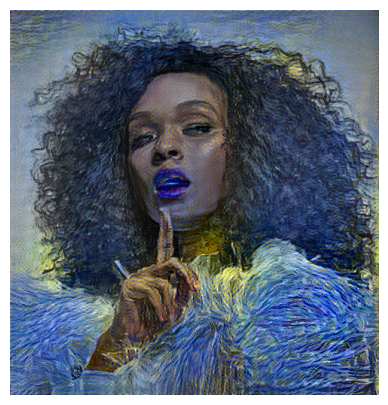

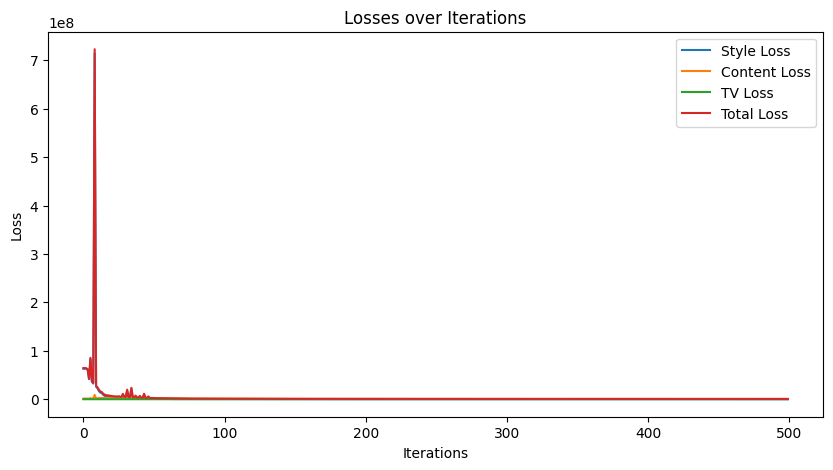

In [ ]:
if (OPTIMIZER=='lbfgs'):
    optimizer = optim.LBFGS([g])
elif (OPTIMIZER=='adam'):
    optimizer = optim.Adam([g], lr=ADAM_LR)

# Stylize without color preservation
out = stylize(iteration=NUM_ITER)

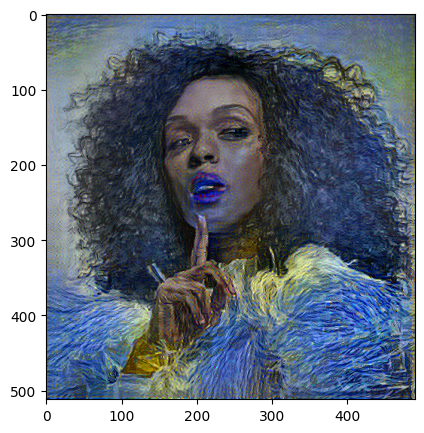

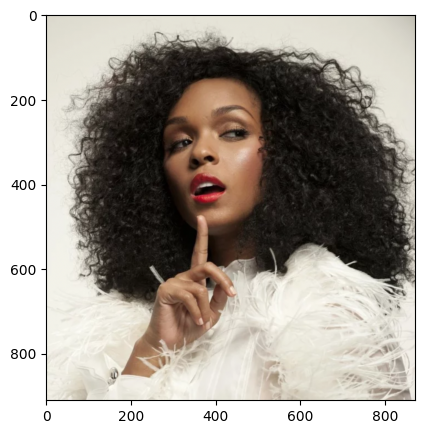

In [ ]:
show(ttoi(g.clone().detach()))
show(content_img)
saveimg(ttoi(g.clone().detach()), NUM_ITER)

if (PRESERVE_COLOR=='True'):
    c_clone = ttoi(content_tensor.clone().detach())
    g_clone = ttoi(g.clone().detach())
    g_preserve = transfer_color(c_clone, g_clone)
    show(g_preserve)
    saveimg(g_preserve, 333)

cuda


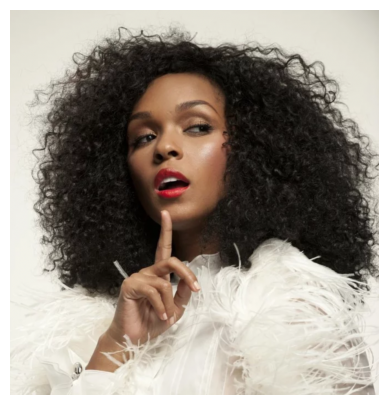

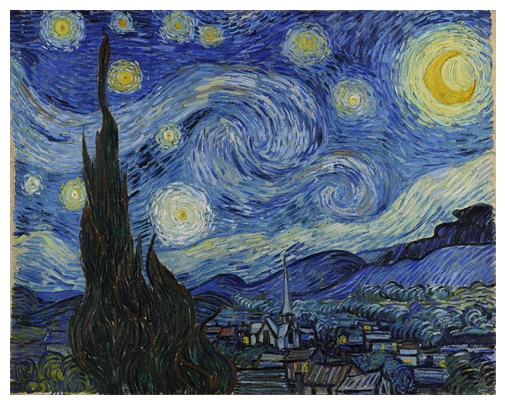

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=None`.
  warnings.warn(msg)


In [ ]:
import torch
import torch.nn as nn
import torch.optim as optim
import copy
import numpy as np
import matplotlib.pyplot as plt
from torchvision import models, transforms
import cv2

# Hyperparameters
MAX_IMAGE_SIZE = 512
OPTIMIZER = 'lbfgs'  # or 'lbfgs'
#ADAM_LR = 10
CONTENT_WEIGHT = 5e0
STYLE_WEIGHT = 1e2
TV_WEIGHT = 1e-3
NUM_ITER = 500
SHOW_ITER = 100

# Image Files
INIT_IMAGE = 'random'  # or 'content'
PRESERVE_COLOR = 'False'  # 'False'
PIXEL_CLIP = 'True'  # or 'False' - Clipping produces better images
CONTENT_PATH = '/content/drive/MyDrive/NST/1-content.png'
STYLE_PATH = '/content/drive/MyDrive/NST/1-style.jpg'
VGG19_PATH = '/content/drive/MyDrive/NST/vgg19-d01eb7cb.pth'
POOL = 'avg'

# Print the device
device = "cuda" if torch.cuda.is_available() else "cpu"
print(device)

# Load image file
def load_image(path):
    img = cv2.imread(path)
    return img

# Show image
def show(img):
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    img = np.array(img / 255).clip(0, 1)
    plt.figure(figsize=(10, 5))
    plt.imshow(img)
    plt.axis('off')  # Turn off axis
    plt.show()

# Save Image as out{num_iterms}.png
def saveimg(img, iters):
    if PIXEL_CLIP == 'True':
        img = img.clip(0, 255)
    cv2.imwrite(f'out{iters}.png', img)

# Color transfer
def transfer_color(src, dest):
    if PIXEL_CLIP == 'True':
        src, dest = src.clip(0, 255), dest.clip(0, 255)

    H, W, _ = src.shape
    dest = cv2.resize(dest, dsize=(W, H), interpolation=cv2.INTER_CUBIC)
    dest_gray = cv2.cvtColor(dest, cv2.COLOR_BGR2GRAY)
    src_yiq = cv2.cvtColor(src, cv2.COLOR_BGR2YCrCb)
    src_yiq[..., 0] = dest_gray
    return cv2.cvtColor(src_yiq, cv2.COLOR_YCrCb2BGR)

# Preprocessing
def itot(img):
    H, W, C = img.shape
    image_size = tuple([int((float(MAX_IMAGE_SIZE) / max([H, W])) * x) for x in [H, W]])

    itot_t = transforms.Compose([
        transforms.ToPILImage(),
        transforms.Resize(image_size),
        transforms.ToTensor()
    ])

    normalize_t = transforms.Normalize([103.939, 116.779, 123.68], [1, 1, 1])
    tensor = normalize_t(itot_t(img) * 255)
    tensor = tensor.unsqueeze(dim=0)
    return tensor

def ttoi(tensor):
    ttoi_t = transforms.Compose([
        transforms.Normalize([-103.939, -116.779, -123.68], [1, 1, 1])])

    tensor = tensor.squeeze()
    img = ttoi_t(tensor)
    img = img.cpu().numpy()
    img = img.transpose(1, 2, 0)
    return img

# Load Images
content_img = load_image(CONTENT_PATH)
style_img = load_image(STYLE_PATH)

# Show Images
show(content_img)
show(style_img)

# Load VGG19 Skeleton
vgg = models.vgg19(pretrained=False)
vgg.load_state_dict(torch.load(VGG19_PATH), strict=False)

# Change Pooling Layer
def pool_(model, pool='avg'):
    if (pool=='avg'):
        ct=0
        for layer in model.children():
            if isinstance(layer, nn.MaxPool2d):
                model[ct] = nn.AvgPool2d(kernel_size=2, stride=2, padding=0, ceil_mode=False)
            ct+=1
    elif (pool=='max'):
        ct=0
        for layer in model.children():
            if isinstance(layer, nn.AvgPool2d):
                model[ct] = nn.MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
            ct+=1

    return model

vgg.features = pool_(vgg.features, POOL)

model = copy.deepcopy(vgg.features)
model.to(device)

for param in model.parameters():
    param.requires_grad = False

mse_loss = torch.nn.MSELoss()
def gram(tensor):
    B, C, H, W = tensor.shape
    x = tensor.view(C, H * W)
    return torch.mm(x, x.t())

def content_loss(g, c):
    loss = mse_loss(g, c)
    return loss

def style_loss(g, s):
    c1, c2 = g.shape
    loss = mse_loss(g, s)
    return loss / (c1 ** 2)

def tv_loss(c):
    x = c[:, :, 1:, :] - c[:, :, :-1, :]
    y = c[:, :, :, 1:] - c[:, :, :, :-1]
    loss = torch.sum(torch.abs(x)) + torch.sum(torch.abs(y))
    return loss

def get_features(model, tensor):
    layers = {
        '3': 'relu1_2',
        '8': 'relu2_2',
        '17': 'relu3_3',
        '26': 'relu4_3',
        '35': 'relu5_3',
        '22': 'relu4_2',
    }

    features = {}
    x = tensor
    for name, layer in model._modules.items():
        x = layer(x)
        if name in layers:
            if name == '22':
                features[layers[name]] = x
            elif name == '31':
                features[layers[name]] = x
            else:
                b, c, h, w = x.shape
                features[layers[name]] = gram(x) / (h * w)
            if name == '35':
                break

    return features

def initial(content_tensor, init_image='random'):
    B, C, H, W = content_tensor.shape
    if init_image == 'random':
        tensor = torch.randn(C, H, W).mul(0.001).unsqueeze(0)
    else:
        tensor = content_tensor.clone().detach()

    return tensor

content_tensor = itot(content_img).to(device)
style_tensor = itot(style_img).to(device)
g = initial(content_tensor, init_image=INIT_IMAGE)
g = g.to(device).requires_grad_(True)

def stylize(iteration=NUM_ITER, preserve_color=False):
    # Initialize lists for storing loss values and iterations
    style_losses = []
    content_losses = []
    tv_losses = []
    total_losses = []
    iterations = []

    # Get features representations/Forward pass
    content_layers = ['relu4_2']
    content_weights = {'relu4_2': 1.0}
    style_layers = ['relu1_2', 'relu2_2', 'relu3_3', 'relu4_3', 'relu5_3']
    style_weights = {'relu1_2': 0.2, 'relu2_2': 0.2, 'relu3_3': 0.2, 'relu4_3': 0.2, 'relu5_3': 0.2}
    c_feat = get_features(model, content_tensor)
    s_feat = get_features(model, style_tensor)

    i = [0]
    while i[0] < iteration:
        def closure():
            # Zero-out gradients
            optimizer.zero_grad()

            # Forward pass
            g_feat = get_features(model, g)

            # Compute Losses
            c_loss = 0
            s_loss = 0
            for j in content_layers:
                c_loss += content_weights[j] * content_loss(g_feat[j], c_feat[j])
            for j in style_layers:
                s_loss += style_weights[j] * style_loss(g_feat[j], s_feat[j])

            c_loss = CONTENT_WEIGHT * c_loss
            s_loss = STYLE_WEIGHT * s_loss
            t_loss = TV_WEIGHT * tv_loss(g.clone().detach())
            total_loss = c_loss + s_loss + t_loss

            # Backprop
            total_loss.backward(retain_graph=True)

            # Append loss values and iteration number
            style_losses.append(s_loss.item())
            content_losses.append(c_loss.item())
            tv_losses.append(t_loss.item())
            total_losses.append(total_loss.item())
            iterations.append(i[0])

            # Print Loss, show and save image
            i[0] += 1
            if (((i[0] % SHOW_ITER) == 1) or (i[0] == NUM_ITER)):
                print("Style Loss: {} Content Loss: {} TV Loss: {} Total Loss : {}".format(s_loss.item(), c_loss.item(),
                                                                                            t_loss, total_loss.item()))
                g_ = ttoi(g.clone().detach())
                show(g_)
                saveimg(g_, i[0] - 1)
                plt.show()

            return total_loss

        # Weight/Pixel update
        optimizer.step(closure)

    if (preserve_color):
        original_colored = ttoi(content_tensor.clone().detach())
        final_with_color = transfer_color(original_colored, g_)
        show(final_with_color)
        saveimg(final_with_color, NUM_ITER)

    # Plotting Combined Graph
    plt.figure(figsize=(10, 5))
    plt.semilogy(iterations, style_losses, label='Style Loss')
    plt.semilogy(iterations, content_losses, label='Content Loss')
    plt.semilogy(iterations, tv_losses, label='TV Loss')
    plt.semilogy(iterations, total_losses, label='Total Loss')
    plt.xlabel('Iterations')
    plt.ylabel('Loss')
    plt.title('Losses over Iterations')
    plt.legend()
    plt.show()

    return g


Style Loss: 8000398.5 Content Loss: 301280.8125 TV Loss: 1.6975393295288086 Total Loss : 8301681.0


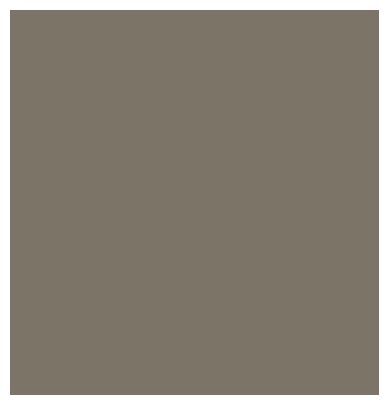

Style Loss: 25127.2890625 Content Loss: 157734.96875 TV Loss: 19669.025390625 Total Loss : 202531.28125


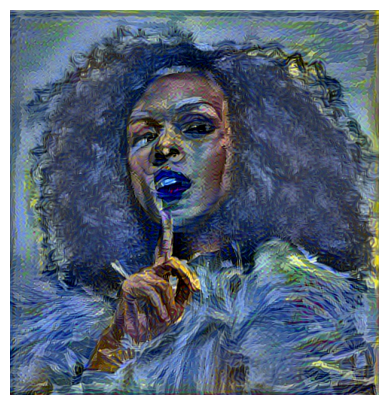

Style Loss: 18248.88671875 Content Loss: 122420.109375 TV Loss: 20126.50390625 Total Loss : 160795.5


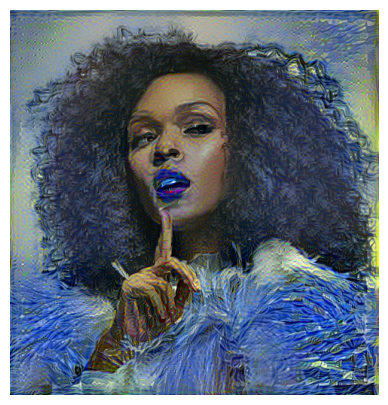

Style Loss: 18388.384765625 Content Loss: 116276.4921875 TV Loss: 20955.58984375 Total Loss : 155620.46875


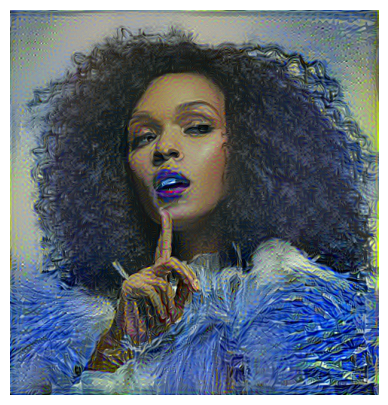

Style Loss: 18505.91796875 Content Loss: 113744.34375 TV Loss: 22161.53125 Total Loss : 154411.796875


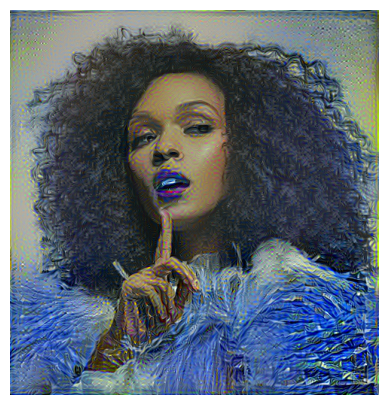

Style Loss: 18602.146484375 Content Loss: 112423.515625 TV Loss: 23392.421875 Total Loss : 154418.09375


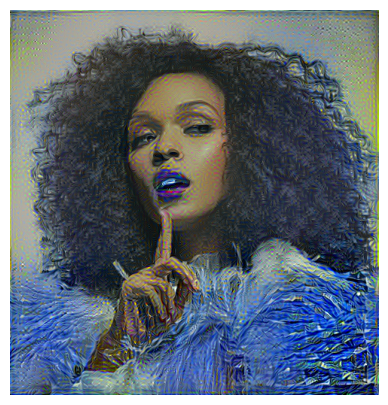

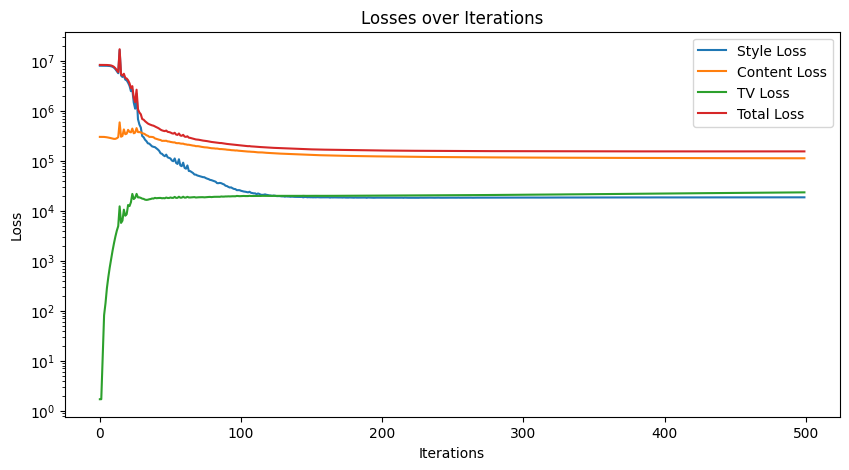

In [ ]:
if (OPTIMIZER=='lbfgs'):
    optimizer = optim.LBFGS([g])
elif (OPTIMIZER=='adam'):
    optimizer = optim.Adam([g], lr=ADAM_LR)

# Stylize without color preservation
out = stylize(iteration=NUM_ITER)

# ***lbfgs with 3000 iteration same weights -> pooling = avg***

cuda


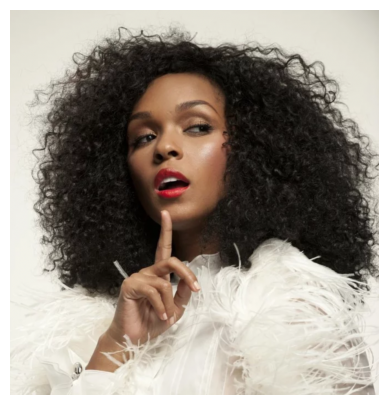

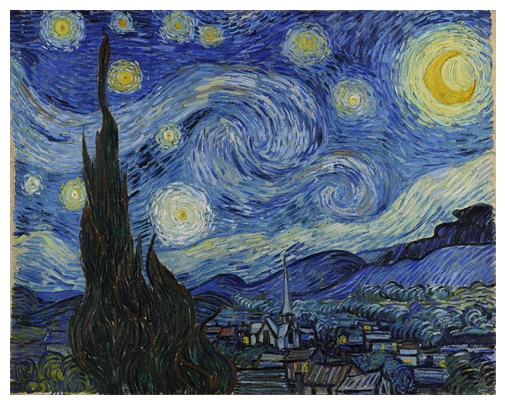

In [ ]:
import torch
import torch.nn as nn
import torch.optim as optim
import copy
import numpy as np
import matplotlib.pyplot as plt
from torchvision import models, transforms
import cv2

# Hyperparameters
MAX_IMAGE_SIZE = 512
OPTIMIZER = 'adam'  # or 'lbfgs'
ADAM_LR = 10
CONTENT_WEIGHT = 5e0
STYLE_WEIGHT = 1e2
TV_WEIGHT = 1e-3
NUM_ITER = 3000
SHOW_ITER = 500

# Image Files
INIT_IMAGE = 'random'  # or 'content'
PRESERVE_COLOR = 'False'  # 'False'
PIXEL_CLIP = 'True'  # or 'False' - Clipping produces better images
CONTENT_PATH = '/content/drive/MyDrive/color preserve/1-content.png'
STYLE_PATH = '/content/drive/MyDrive/color preserve/1-style.jpg'
VGG19_PATH = '/content/drive/MyDrive/color preserve/vgg19-d01eb7cb.pth'
POOL = 'avg'

# Print the device
device = "cuda" if torch.cuda.is_available() else "cpu"
print(device)

# Load image file
def load_image(path):
    img = cv2.imread(path)
    return img

# Show image
def show(img):
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    img = np.array(img / 255).clip(0, 1)
    plt.figure(figsize=(10, 5))
    plt.imshow(img)
    plt.axis('off')  # Turn off axis
    plt.show()

# Save Image as out{num_iterms}.png
def saveimg(img, iters):
    if PIXEL_CLIP == 'True':
        img = img.clip(0, 255)
    cv2.imwrite(f'out{iters}.png', img)

# Color transfer
def transfer_color(src, dest):
    if PIXEL_CLIP == 'True':
        src, dest = src.clip(0, 255), dest.clip(0, 255)

    H, W, _ = src.shape
    dest = cv2.resize(dest, dsize=(W, H), interpolation=cv2.INTER_CUBIC)
    dest_gray = cv2.cvtColor(dest, cv2.COLOR_BGR2GRAY)
    src_yiq = cv2.cvtColor(src, cv2.COLOR_BGR2YCrCb)
    src_yiq[..., 0] = dest_gray
    return cv2.cvtColor(src_yiq, cv2.COLOR_YCrCb2BGR)

# Preprocessing
def itot(img):
    H, W, C = img.shape
    image_size = tuple([int((float(MAX_IMAGE_SIZE) / max([H, W])) * x) for x in [H, W]])

    itot_t = transforms.Compose([
        transforms.ToPILImage(),
        transforms.Resize(image_size),
        transforms.ToTensor()
    ])

    normalize_t = transforms.Normalize([103.939, 116.779, 123.68], [1, 1, 1])
    tensor = normalize_t(itot_t(img) * 255)
    tensor = tensor.unsqueeze(dim=0)
    return tensor

def ttoi(tensor):
    ttoi_t = transforms.Compose([
        transforms.Normalize([-103.939, -116.779, -123.68], [1, 1, 1])])

    tensor = tensor.squeeze()
    img = ttoi_t(tensor)
    img = img.cpu().numpy()
    img = img.transpose(1, 2, 0)
    return img

# Load Images
content_img = load_image(CONTENT_PATH)
style_img = load_image(STYLE_PATH)

# Show Images
show(content_img)
show(style_img)

# Load VGG19 Skeleton
vgg = models.vgg19(pretrained=False)
vgg.load_state_dict(torch.load(VGG19_PATH), strict=False)

# Change Pooling Layer
def pool_(model, pool='avg'):
    if (pool=='avg'):
        ct=0
        for layer in model.children():
            if isinstance(layer, nn.MaxPool2d):
                model[ct] = nn.AvgPool2d(kernel_size=2, stride=2, padding=0, ceil_mode=False)
            ct+=1
    elif (pool=='max'):
        ct=0
        for layer in model.children():
            if isinstance(layer, nn.AvgPool2d):
                model[ct] = nn.MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
            ct+=1

    return model

vgg.features = pool_(vgg.features, POOL)

model = copy.deepcopy(vgg.features)
model.to(device)

for param in model.parameters():
    param.requires_grad = False

mse_loss = torch.nn.MSELoss()
def gram(tensor):
    B, C, H, W = tensor.shape
    x = tensor.view(C, H * W)
    return torch.mm(x, x.t())

def content_loss(g, c):
    loss = mse_loss(g, c)
    return loss

def style_loss(g, s):
    c1, c2 = g.shape
    loss = mse_loss(g, s)
    return loss / (c1 ** 2)

def tv_loss(c):
    x = c[:, :, 1:, :] - c[:, :, :-1, :]
    y = c[:, :, :, 1:] - c[:, :, :, :-1]
    loss = torch.sum(torch.abs(x)) + torch.sum(torch.abs(y))
    return loss

def get_features(model, tensor):
    layers = {
        '3': 'relu1_2',
        '8': 'relu2_2',
        '17': 'relu3_3',
        '26': 'relu4_3',
        '35': 'relu5_3',
        '22': 'relu4_2',
    }

    features = {}
    x = tensor
    for name, layer in model._modules.items():
        x = layer(x)
        if name in layers:
            if name == '22':
                features[layers[name]] = x
            elif name == '31':
                features[layers[name]] = x
            else:
                b, c, h, w = x.shape
                features[layers[name]] = gram(x) / (h * w)
            if name == '35':
                break

    return features

def initial(content_tensor, init_image='random'):
    B, C, H, W = content_tensor.shape
    if init_image == 'random':
        tensor = torch.randn(C, H, W).mul(0.001).unsqueeze(0)
    else:
        tensor = content_tensor.clone().detach()

    return tensor

content_tensor = itot(content_img).to(device)
style_tensor = itot(style_img).to(device)
g = initial(content_tensor, init_image=INIT_IMAGE)
g = g.to(device).requires_grad_(True)

def stylize(iteration=NUM_ITER, preserve_color=False):
    # Initialize lists for storing loss values and iterations
    style_losses = []
    content_losses = []
    tv_losses = []
    total_losses = []
    iterations = []

    # Get features representations/Forward pass
    content_layers = ['relu4_2']
    content_weights = {'relu4_2': 1.0}
    style_layers = ['relu1_2', 'relu2_2', 'relu3_3', 'relu4_3', 'relu5_3']
    style_weights = {'relu1_2': 0.2, 'relu2_2': 0.2, 'relu3_3': 0.2, 'relu4_3': 0.2, 'relu5_3': 0.2}
    c_feat = get_features(model, content_tensor)
    s_feat = get_features(model, style_tensor)

    i = [0]
    while i[0] < iteration:
        def closure():
            # Zero-out gradients
            optimizer.zero_grad()

            # Forward pass
            g_feat = get_features(model, g)

            # Compute Losses
            c_loss = 0
            s_loss = 0
            for j in content_layers:
                c_loss += content_weights[j] * content_loss(g_feat[j], c_feat[j])
            for j in style_layers:
                s_loss += style_weights[j] * style_loss(g_feat[j], s_feat[j])

            c_loss = CONTENT_WEIGHT * c_loss
            s_loss = STYLE_WEIGHT * s_loss
            t_loss = TV_WEIGHT * tv_loss(g.clone().detach())
            total_loss = c_loss + s_loss + t_loss

            # Backprop
            total_loss.backward(retain_graph=True)

            # Append loss values and iteration number
            style_losses.append(s_loss.item())
            content_losses.append(c_loss.item())
            tv_losses.append(t_loss.item())
            total_losses.append(total_loss.item())
            iterations.append(i[0])

            # Print Loss, show and save image
            i[0] += 1
            if (((i[0] % SHOW_ITER) == 1) or (i[0] == NUM_ITER)):
                print("Style Loss: {} Content Loss: {} TV Loss: {} Total Loss : {}".format(s_loss.item(), c_loss.item(),
                                                                                            t_loss, total_loss.item()))
                g_ = ttoi(g.clone().detach())
                show(g_)
                saveimg(g_, i[0] - 1)
                plt.show()

            return total_loss

        # Weight/Pixel update
        optimizer.step(closure)

    if (preserve_color):
        original_colored = ttoi(content_tensor.clone().detach())
        final_with_color = transfer_color(original_colored, g_)
        show(final_with_color)
        saveimg(final_with_color, NUM_ITER)

    # Plotting Combined Graph
    plt.figure(figsize=(10, 5))
    plt.plot(iterations, style_losses, label='Style Loss')
    plt.plot(iterations, content_losses, label='Content Loss')
    plt.plot(iterations, tv_losses, label='TV Loss')
    plt.plot(iterations, total_losses, label='Total Loss')
    plt.xlabel('Iterations')
    plt.ylabel('Loss')
    plt.title('Losses over Iterations')
    plt.legend()
    plt.show()

    return g

Style Loss: 8000398.5 Content Loss: 301280.8125 TV Loss: 1.6941224336624146 Total Loss : 8301681.0


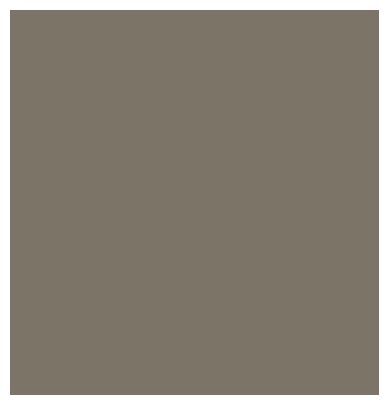

Style Loss: 18273.4609375 Content Loss: 122296.984375 TV Loss: 28143.23828125 Total Loss : 168713.671875


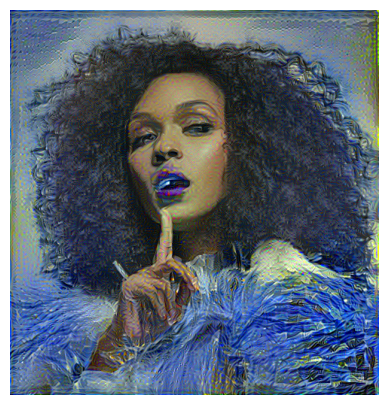

Style Loss: 19010.916015625 Content Loss: 115126.890625 TV Loss: 29450.619140625 Total Loss : 163588.4375


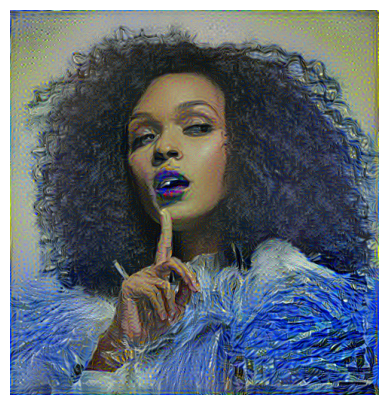

Style Loss: 1863090.25 Content Loss: 298276.34375 TV Loss: 33043.27734375 Total Loss : 2194409.75


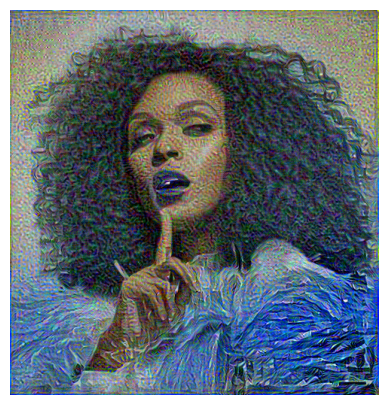

Style Loss: 18780.146484375 Content Loss: 114083.3984375 TV Loss: 31082.296875 Total Loss : 163945.84375


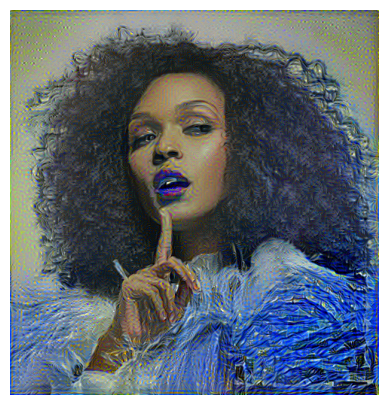

Style Loss: 19027.19921875 Content Loss: 112601.125 TV Loss: 32189.6640625 Total Loss : 163818.0


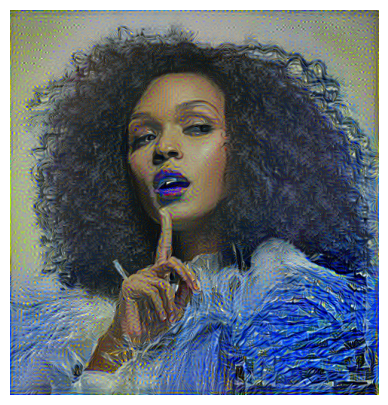

Style Loss: 19920.255859375 Content Loss: 134381.546875 TV Loss: 36448.88671875 Total Loss : 190750.6875


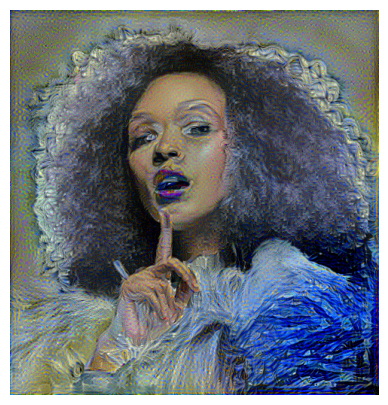

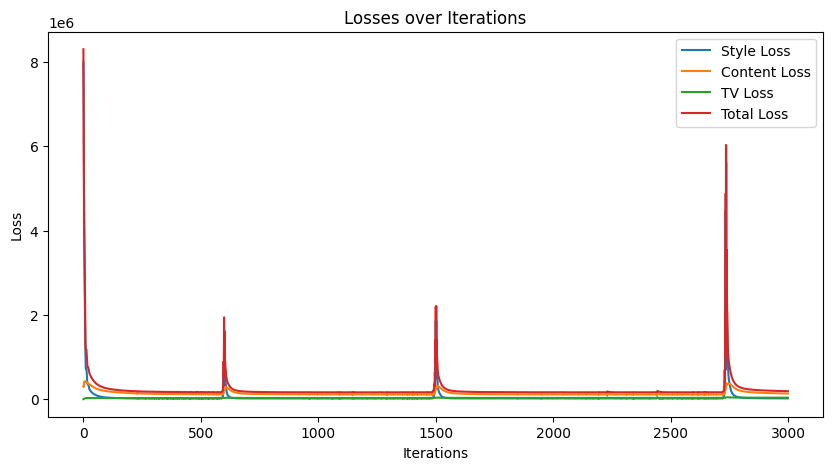

In [ ]:
if (OPTIMIZER=='lbfgs'):
    optimizer = optim.LBFGS([g])
elif (OPTIMIZER=='adam'):
    optimizer = optim.Adam([g], lr=ADAM_LR)

# Stylize without color preservation
out = stylize(iteration=NUM_ITER)